# Network pruning.

## Contents.
* [Introduction](#intro)
* [Imports](#imports)
* [Parameters](#parameters)
* [Data and functions](#data)
* [Bistability of the original GRN](#original)
* [Pruning the original network](#prune)
* [Experiment of gene knock-outs](#knock)

## Introduction. <a class="anchor" id="intro"></a>

We start from the Gene Regulatory Network (GRN) detailed in the figure below. In this notebook we show:

* Bistability of the 52-node network. We project our results into two nodes: NANOG and GATA6.
* Pruning of the nodes that are note essential to keep the bistability.

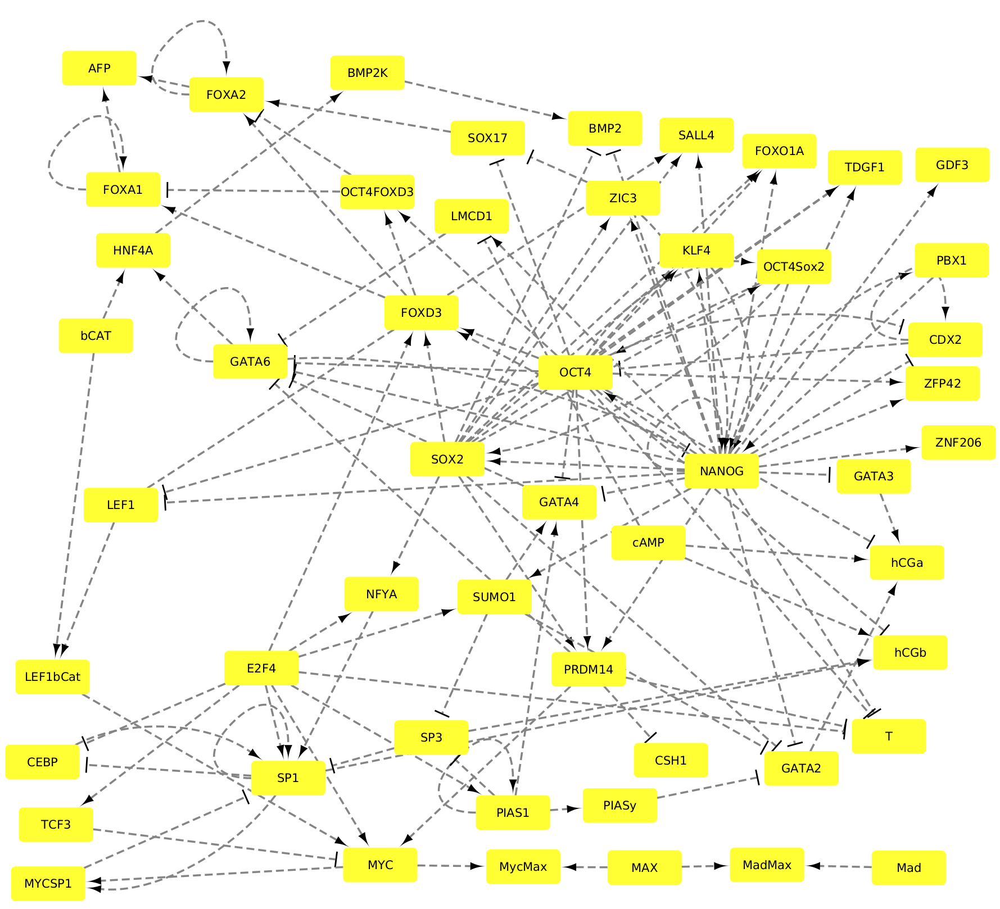

Diagram of the stem cell developmental network. It is made up of 52 nodes, which represent different genes. The connections may represent either activations (arrows), or repressions (perpendicular, T-shaped). 

## Imports. <a class="anchor" id="imports"></a>

Each package can be installed with the commented lines above every `using` instance.

In [1]:
# Import necessary packages:
#import Pkg; Pkg.add("DifferentialEquations")
using DifferentialEquations
#import Pkg; Pkg.add("DiffEqProblemLibrary")
using DiffEqProblemLibrary
#import Pkg; Pkg.add("Random")
using Random
#import Pkg; Pkg.add("PyPlot")
using PyPlot
#import Pkg; Pkg.add("Distributions")
using Distributions
#import Pkg; Pkg.add("DelimitedFiles")
using DelimitedFiles
#import Pkg; Pkg.add("CSV")
using CSV

┌ Info: Precompiling CSV [336ed68f-0bac-5ca0-87d4-7b16caf5d00b]
└ @ Base loading.jl:1317


## Parameters. <a class="anchor" id="parameters"></a>
We state the parameters used to analyze the system of ODEs that represents the GRN:

$\dot{x}_i = F_i,\;\; i=1,2,...,52, \label{eq:52}$,

where $F_i$ is given by

$F_i = \sum_{j\in A_{ij}}{\frac{ax_j^n}{S^n + x_j^n}} + \sum_{j\in B_{ij}}{\frac{bS^n}{S^n + x_j^n}} - kx_i$,

where $S$ controls the strength of the regulatory interactions by allowing to tune the threshold value above on which the activator/repressor has an effect. The Hill coefficient $n$ determines the sigmoidal function's steepness. The self-degradation constant is $k$. The repression constant is $b$. The activation constant is $a$. In the summation subindex, $A_{i,j}$ represents the set of activator nodes acting on $i$, while $B_{i,j}$ represents the set of repressor nodes acting on $i$. The first term in the equation represents self-degradation, the second term the activation from node $i$ to node $j$, and the third term the repression from node $i$ to node $j$. 


In [4]:
S = 0.5   # strength of regulatory interaction
n = 3     # Hill coefficient
a = 0.38  # Activation constant
b = 0.5   # Repression constant
k = 1.0   # Self-degradation constant
;

`m52` is a list of lists that describes the interactions between nodes in the network.

In [5]:
include("./Data/m52.txt");

For instance, the first 10 interactions in the network are shown below. The first element of each list represents the node origin of the interaction, and the second represents the node target. The third element is either `1` for activation or `-1` for repression.

In [6]:
m52[1:10]

10-element Vector{Vector{Int64}}:
 [1, 8, 1]
 [1, 10, 1]
 [1, 4, 1]
 [1, 32, 1]
 [1, 43, 1]
 [1, 5, 1]
 [1, 14, -1]
 [1, 6, 1]
 [1, 15, -1]
 [1, 16, -1]

Besides, we also need to declare some parameters to repeatedly solve the system of ODEs:

In [7]:
tspan = (0.0,50.0) # Time span
repetitions = 1e4  # Number of times we solve the system of ODEs
;

It is important to explore the whole space of initial conditions. The minimum possible concentration is 0. We calculate the maximum concentration $x_i$ in the function $F_i=0$ by setting $x_j \rightarrow +\infty,\; \forall j\neq i$ and $x_j \rightarrow 0,\; \forall j\neq i$. The former case yields

$x_i = (\sum{a})/k$,

while the latter yields

$x_i = (\sum{b})/k$,

thus, the maximum possible concentration of $x_i$ corresponds to the addition:

$x_i = (\sum_{j\in A_{i,j}}{a} + \sum_{j\in B_{i,j}}{b})/k$,

In [9]:
# Find maximum for initial condition:
x_max = zeros(52)

# max = 1/k * ( sum(a) + sum(b))
for i in m52
    if i[3] == 1
        x_max[i[2]] += a
        
    else
        x_max[i[2]] += b
    end
end

# Initial condition: (0., max(x_max/k))
x_max = x_max./k
final_ic = maximum(x_max)

2.88

Our initial conditions will be random concentrations, uniformly distributed between 0 and 2.88---one concentration per node.

## Data and functions. <a class="anchor" id="data"></a>

The following function uses the list `m52` (or sparse matrix) to define the system of ODEs.

In [6]:
# Function to describe TF (nodes) connections:
function ode52(x,p,t)
    
    xi = zeros(52) #52 factors
    
    for i in 1:52
        xi[i] -= k*x[i]
    end

    #Sum over the different connections in the sparse matrix
    for i in m52

        # If i[3]==1, we have an activator:
        if i[3] == 1
            xi[i[2]] += a*x[i[1]]^n/(S^n + x[i[1]]^n)
        # If i[3]==-1, we have a repressor:
        else
            xi[i[2]] += b*S^n/(S^n + x[i[1]]^n)
        end
    end

    return xi
end;

The following functions are used to:
* `ode_problem_solver` repeatedly solve a system of ODEs, and 
* `get_n_weights-alt` to find the number of attractors, their weight (or proportion of solutions that tend to an attractor), and the value of the attractor.

In [7]:
include("./functions/ode_problem_solver.txt")
include("./functions/get_n_weights-alt.txt")
;

The following variable `names_ordered` includes the names of each of the 52 genes. In the matrix `m52`, node 1 is OCT4, 2 is SOX2, 3 is NANOG, etc. GATA6 is node 16.

In [8]:
include("./Data/names_ordered.txt");

In [9]:
names_ordered[1:5]

("OCT4", "SOX2", "NANOG", "OCT4Sox2", "KLF4")

In [10]:
names_ordered[16]

"GATA6"

Function for plotting:

In [11]:
# Plotting all solutions for each node, on different plots:
# sol: solution to the system of ODEs, obtained from function ode_problem_solver
# nodes_here: nodes to plot
# node_name: if we want to include a title for the plot, which is the name of the node or nodes
# reps: number of repetitions we used in ode_problem_solver
# path_save: if we want to save the plot as an image, state the path
# format_save: choose the format of the image to save (e.g., format_save="png").
function plot_sol(sol,nodes_here,node_name,reps,path_save=false, format_save="png")
    PyPlot.figure(figsize=(10,6))
        
    for i in 1:Int(reps)
        positions = [i[nodes_here]  for i in sol[i].u] 
        PyPlot.plot(sol[i].t,positions,linewidth=1,alpha = 0.5)
    end
    
    PyPlot.title(node_name, fontsize = 24)
    PyPlot.xlabel("Time", fontsize = 20)
    PyPlot.ylabel("Concentration", fontsize = 20)
    PyPlot.xlim(tspan)
    PyPlot.ylim(0)
    PyPlot.xticks(fontsize = 18)
    PyPlot.yticks(fontsize = 18)
    PyPlot.show()
    
    if length(path_save)>1
        PyPlot.savefig(path_save, format=format_save)
    end

end  # ends function;

## Bistability of the original GRN. <a class="anchor" id="original"></a>

With our functions it is very simple to repeatedly solve the system of ODEs a number of times:

In [12]:
# Solve the problem a number of repetitions:
# First, specify the number of nodes,
# second, function that describes the system of ODEs,
# third, the number of times we want to solve the system,
# and the parameters for the ODEs, in the order [a,b,n,S,k]:
sol_52 = ode_problem_solver(52, ode52, repetitions, [a, b, n, S, k]);

Once we obtain the solution, we can calculate the attractors of a node. The outputs are:
+ The number of attractors.
+ The proportion of solutions that tend to each attractor.
+ The value of the attractors.

In [13]:
# Obtain the attractors for NANOG:
# first argument is a list of numbers (here, the 10,000 final points of NANOG),
# second we state the number of repetitions, and,
# third, the minimum distance needed to tell two attractors apart:
nanog_52 = get_n_weights_alt([sol_52[i].u[end][3] for i in 1:Int(repetitions)],repetitions,0.1)

3-element Vector{Any}:
 2
  [0.9986, 0.0014]
  [1.3191262399363757, 0.0059542859812900095]

In [14]:
# Obtain the attractors for GATA6:
gata6_52 = get_n_weights_alt([sol_52[i].u[end][16] for i in 1:Int(repetitions)],repetitions,0.1)

3-element Vector{Any}:
 2
  [0.9986, 0.0014]
  [1.037870788546553, 2.1809888154896337]

Besides, we can also easily plot the solutions of a node:

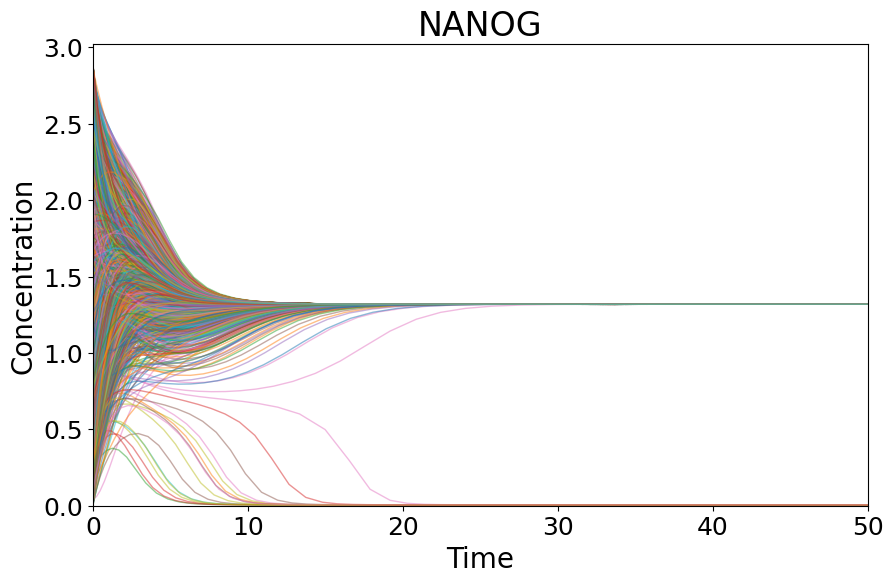

In [22]:
node_num = 3  # List of nodes to plot (3=NANOG)
num_nodes = 52  # Total number of nodes
node_str = names_ordered[node_num]  # Get the names of the nodes to plot
plot_sol(sol_52,node_num,node_str,repetitions)

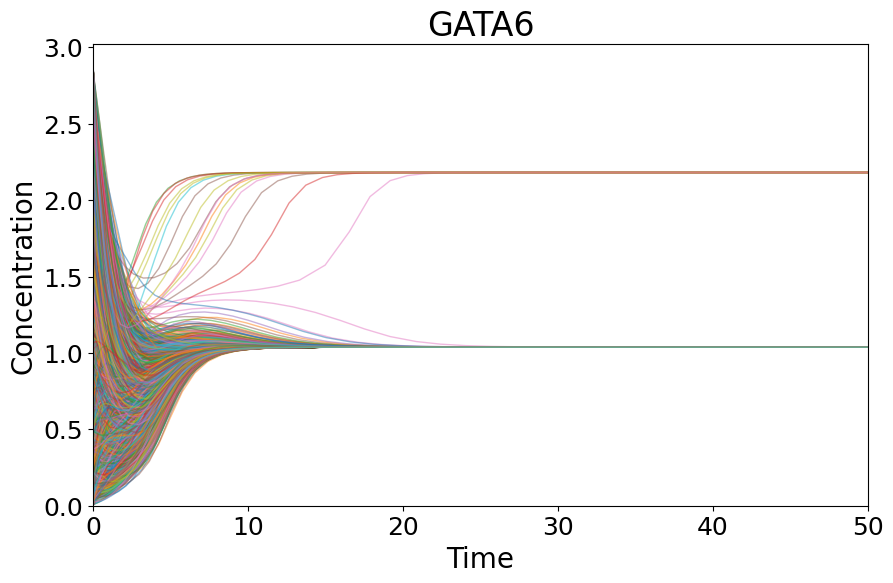

In [23]:
node_num = 16  # List of nodes to plot (16=GATA6)
num_nodes = 52  # Total number of nodes
node_str = names_ordered[node_num]  # Get the names of the nodes to plot
plot_sol(sol_52,node_num,node_str,repetitions)

## Pruning the original network. <a class="anchor" id="prune"></a>

We'll begin pruning by selecting the downstream nodes (those that receive connections but do not send them). Then, from the resulting network, keep recursively selecting the downstream nodes until none are left.

In [34]:
# From the original m52 list of lists that describes the network
# we are going to select only the downstream nodes.
m52_prunned = copy(m52);

In [35]:
# Initialize a vector with sources and targets in the network:
source = []; target = [];
# Initialize vectors with source and target names:
source_names = []; target_names = [];
# Initialize a vector with activations ("true") or repression ("false"):
interaction = []
for i in m52
    push!(source,i[1])
    push!(target,i[2])
    push!(source_names,names_ordered[i[1]])
    push!(target_names,names_ordered[i[2]])
    if i[3] == 1
        push!(interaction,"true") # Indicates activation
    else
        push!(interaction,"false") # Indicates repression
    end
end;

In [37]:
# upstream: do not "receive" connections
# we can know these by cheking if a target doesnt exist
upstream = []
for i in 1:52
    # If the node sends connections
    if i in target
        push!(upstream,0)
    # If the node does not receive a connection it is upstream:
    else
        push!(upstream,1)
    end
end;

Prune the network by checking whether each connection in `m52` corresponds to a downstream connection. If so, delete the connection in `m52_prunned`, which is initially a copy of `m52`.

In [38]:
# downstream: do not "send" connections
# we can know these by checking if a source doesnt exist
downstream = []
index_down = []
for i in 1:52
    # If the node sends connections
    if i in source
        push!(downstream,0)
    # If the node does not send a connection it is downstream:
    else
        push!(downstream,2)
        push!(index_down,i)
    end
end;

In [39]:
# Remove edges downstream:
for i in m52
    if i[2] in index_down
        deleteat!(m52_prunned,findall(x->x==i,m52_prunned))
    end
end

Now we repeat the process iteratively, until the network cannot be reduced anymore.

In [40]:
# Length of the matrix we prune:
len_it = length(m52_prunned);
# Control length to check if the network is being reduced:
len_new = 0;
# Compare lengths, then prune if the network may be further reduced,
# stop when it may not.
while len_it != len_new
    
    # The pre-prune length for this iteration:
    len_it = length(m52_prunned)
    
    # Get the sources in the pruned network:
    source_new = [];
    for i in m52_prunned
        push!(source_new,i[1])
    end;
    
    # Get the new nodes that are downstream:
    for i in 1:52
        if i in source_new
            push!(downstream,0)
        # If the node does not send a connection it is downstream:
        else
            push!(downstream,2)
        end
    end
    
    # Get the indexes of the nodes that are downstream:
    index_down = [];
    for i in 1:52
        # If the node does not send connections it is downstream:
        if i ∉ source_new
            push!(index_down,i)
        end
    end;
    
    # Remove edges downstream:
    for i in m52
        # If the target is one of the downstream nodes,
        # delete the component in the network:
        if i[2] in index_down
            deleteat!(m52_prunned,findall(x->x==i,m52_prunned))
        end
    end
    
    # The post-prune length for this iteration:
    len_new = length(m52_prunned)
end  # ends while loop

The code above does note identify as downstream nodes that have a self loop.

We check if there are any:

In [41]:
self_down = []
for i in 1:(length(m52_prunned)-1)
    # If there is a self loop and
    # there are no more connections than the self-loop:
    if m52_prunned[i][1] == m52_prunned[i][2] && m52_prunned[i+1][1] != m52_prunned[i][1]
        
        # Save the connection that fulfills these:
        push!(self_down,m52_prunned[i])
    end
end;

In [42]:
# Delete the connections found to be self-loops that are downstream:
for i in self_down
    deleteat!(m52_prunned,findall(x->x==i,m52_prunned))
end

In [45]:
# Include in variabl downstream these self-loops:
for i in self_down
    downstream[157 + i[1] - 1] = 2
end;

In [47]:
# # Print the pruned matrix:
# for i in m52_prunned
#     println("[",names_ordered[i[1]],",",names_ordered[i[2]],",",i[3],"]")
# end

Once the downstream nodes that have a self-loop have been removed there may be other newly downstream nodes.

In [48]:
# Length of the matrix we prune:
len_it = length(m52_prunned);
# Control length to check if the network is being reduced:
len_new = 0;
# Compare lengths, then prune if the network may be further reduced,
# stop when it may not.
while len_it != len_new
    
    # The pre-prune length:
    len_it = length(m52_prunned)
    
    # Get the sources in the pruned network:
    source_new = [];
    for i in m52_prunned
        push!(source_new,i[1])
    end;
    
    # Get the new nodes that are downstream
    for i in 1:52
        if i in source_new
            push!(downstream,0)
        # If the node does not send a connection it is downstream:
        else
            push!(downstream,2)
        end
    end
    
    # Get the indexes of the nodes that are downstream:
    index_down = [];
    for i in 1:52
        # If the node does not send connections it is downstream
        if i ∉ source_new
            push!(index_down,i)
        end
    end;
    
    # Remove edges downstream:
    for i in m52
        # If the target is one of the downstream nodes,
        # delete the component in the network:
        if i[2] in index_down
            deleteat!(m52_prunned,findall(x->x==i,m52_prunned))
        end
    end
    
    # The post-prune length:
    len_new = length(m52_prunned)
end  # ends while loop

In [15]:
for i in m52_prunned
    println(i)
end

[1, 4, 1]
[1, 5, 1]
[1, 15, -1]
[1, 16, -1]
[1, 46, 1]
[1, 33, -1]
[1, 22, -1]
[2, 4, 1]
[2, 7, 1]
[2, 5, 1]
[2, 42, 1]
[2, 46, 1]
[3, 3, 1]
[3, 1, 1]
[3, 11, 1]
[3, 2, 1]
[3, 7, 1]
[3, 5, 1]
[3, 15, -1]
[3, 50, 1]
[3, 16, -1]
[3, 46, 1]
[3, 33, -1]
[3, 22, -1]
[3, 35, 1]
[4, 2, 1]
[4, 3, 1]
[4, 1, 1]
[5, 3, 1]
[7, 3, 1]
[11, 3, 1]
[15, 16, -1]
[16, 16, 1]
[16, 3, -1]
[22, 22, 1]
[22, 1, -1]
[23, 34, 1]
[26, 35, -1]
[28, 48, 1]
[30, 39, 1]
[30, 42, 1]
[30, 50, 1]
[30, 44, 1]
[30, 28, -1]
[30, 51, 1]
[30, 48, 1]
[33, 34, 1]
[34, 39, 1]
[35, 16, -1]
[39, 41, 1]
[41, 48, -1]
[42, 48, 1]
[44, 44, 1]
[44, 15, 1]
[44, 49, -1]
[46, 16, -1]
[46, 39, 1]
[48, 48, 1]
[48, 28, -1]
[48, 41, 1]
[49, 48, -1]
[50, 49, -1]
[50, 15, 1]
[51, 39, -1]


We now have a new sparse matrix to describe the system of ODEs of the pruned network. The problem is that we have kept the same numeration of nodes as in the pre-pruned network. We need to re-write the order of the nodes.

In [51]:
# New order of genes in the pruned network:
names_ordered_pruned = unique([names_ordered[i[1]] for i in m52_prunned])
println(names_ordered_pruned)

["OCT4", "SOX2", "NANOG", "OCT4Sox2", "KLF4", "ZIC3", "PBX1", "GATA4", "GATA6", "CDX2", "bCAT", "cAMP", "CEBP", "E2F4", "LEF1", "LEF1bCat", "LMCD1", "MYC", "MYCSP1", "NFYA", "PIAS1", "PRDM14", "SP1", "SP3", "SUMO1", "TCF3"]


In [53]:
# Create a list of the remaining indeces
# if they are no longer in the matrix,
# substitute with a 0.
after_indexes = []
count = 1
for i in 1:length(names_ordered)
    if names_ordered[i] ∈ names_ordered_pruned
        append!(after_indexes,count)
        count += 1
    else
        append!(after_indexes,0)
    end
end

In [86]:
# NANOG new index:
println(after_indexes[3])
# GATA6 new index:
println(after_indexes[16])

3
9


We call `m26` to the resulting sparse matrix (because it has 26 nodes, instead of the 52 of the original):

In [54]:
# This way we can save a matrix for the pruned network
m26 = []
for i in m52_prunned
    push!(m26,[after_indexes[i[1]],after_indexes[i[2]],i[3]])
end

One may save the resulting list of lists `m26` to a text file by copy-pasting the list Julia prints:

In [76]:
# Print the pruned network in "julia format"
# copy and paste into a txt the output:
println("m26 = [")
for i in m26
    println(i,",")
end
println("]")

m26 = [
[1, 4, 1],
[1, 5, 1],
[1, 8, -1],
[1, 9, -1],
[1, 22, 1],
[1, 15, -1],
[1, 10, -1],
[2, 4, 1],
[2, 6, 1],
[2, 5, 1],
[2, 20, 1],
[2, 22, 1],
[3, 3, 1],
[3, 1, 1],
[3, 7, 1],
[3, 2, 1],
[3, 6, 1],
[3, 5, 1],
[3, 8, -1],
[3, 25, 1],
[3, 9, -1],
[3, 22, 1],
[3, 15, -1],
[3, 10, -1],
[3, 17, 1],
[4, 2, 1],
[4, 3, 1],
[4, 1, 1],
[5, 3, 1],
[6, 3, 1],
[7, 3, 1],
[8, 9, -1],
[9, 9, 1],
[9, 3, -1],
[10, 10, 1],
[10, 1, -1],
[11, 16, 1],
[12, 17, -1],
[13, 23, 1],
[14, 18, 1],
[14, 20, 1],
[14, 25, 1],
[14, 21, 1],
[14, 13, -1],
[14, 26, 1],
[14, 23, 1],
[15, 16, 1],
[16, 18, 1],
[17, 9, -1],
[18, 19, 1],
[19, 23, -1],
[20, 23, 1],
[21, 21, 1],
[21, 8, 1],
[21, 24, -1],
[22, 9, -1],
[22, 18, 1],
[23, 23, 1],
[23, 13, -1],
[23, 19, 1],
[24, 23, -1],
[25, 24, -1],
[25, 8, 1],
[26, 18, -1],
]


### Get the pruned network in Cytoscape format:

Uncommenting the lines below, one can import the network obtained here into a format suitable to visualize in Cytoscape.

The reader needs only to uncomment the cells below, and, in the functions `open()`, add a directory to save a CSV file.

In [13]:
# # We want the last 52 components of downstream
# println(416 - 52 + 1)
# # so we need to call downstream[365:416]
# println(length(downstream[365:416]))

In [26]:
# # Save the information obtained on whether the nodes are upstream or downstream:
# header = ["node" "up_or_downstream"]
# open("", "w") do io
#     writedlm(io, [header; collect(names_ordered) collect(upstream + downstream[365:416])])
# end

In [27]:
# # Get a vector with sources and targets in the network:
# source_prune = []; target_prune = [];
# # Get vectors with source and target names:
# source_names_prune = []; target_names_prune = [];
# # Get a vector with activations ("true") or repression ("false"):
# interaction_prune = []
# for i in m52_prunned
#     push!(source_prune,i[1])
#     push!(target_prune,i[2])
#     push!(source_names_prune,names_ordered[i[1]])
#     push!(target_names_prune,names_ordered[i[2]])
#     if i[3] == 1
#         push!(interaction_prune,"true") # Indicates activation
#     else
#         push!(interaction_prune,"false") # Indicates repression
#     end
# end;

In [28]:
# File for cytoscape:
# Header of file:
# header = ["index" "source" "target" "activation"];
# Save file:
# open("", "w") do io
#     writedlm(io, [header; collect(1:length(m52_prunned)) source_names_prune target_names_prune interaction_prune])
# end

The resulting network looks like this after importing to Cytoscape:

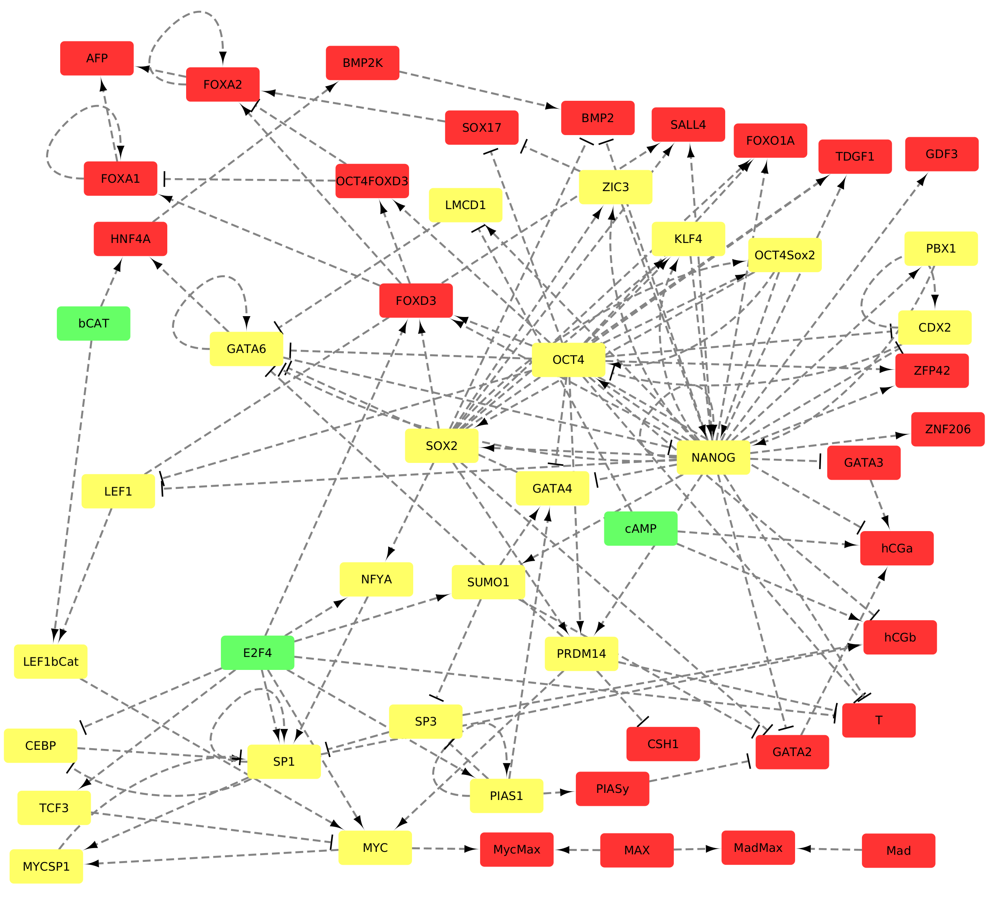

Each node is colored depending on whether it is upstream (i.e., source of connections butnot target, in green), downstream (i.e., target of connections but not source, in red) or neither (source and target of connections, in yellow).

Ignoring the downstream nodes, we obtain:

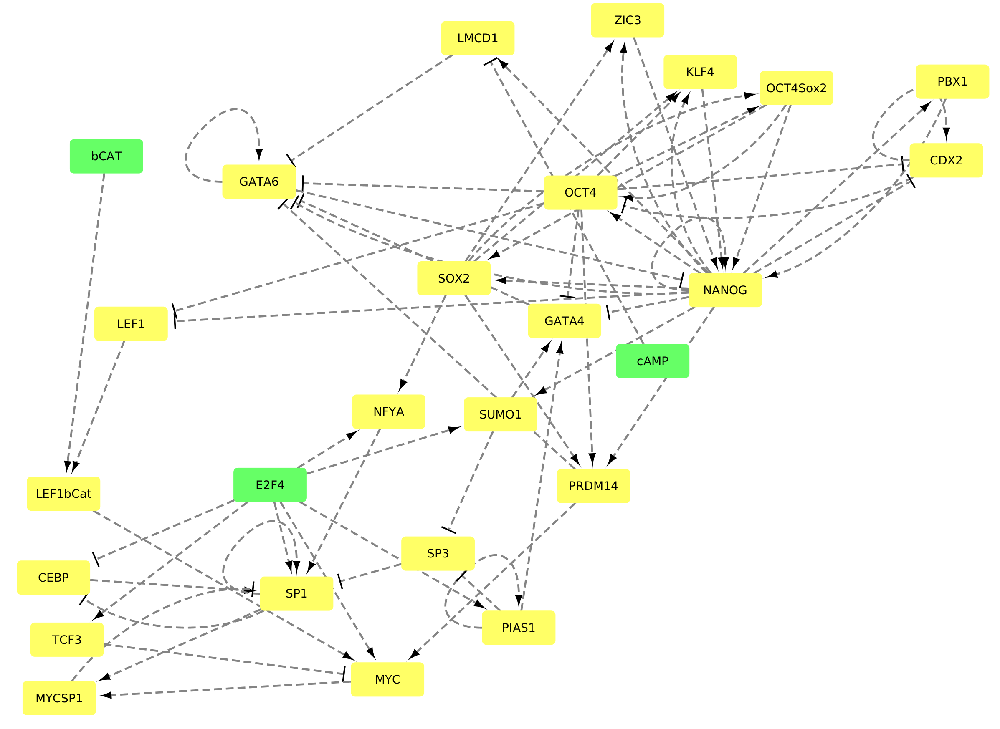

### Bistability of the 26-node network.

New function to describe the system of 26 ODEs:

In [18]:
# Function to describe TF (nodes) connections:
function ode26(x,p,t)
    
    xi = zeros(26) #26 factors
    
    for i in 1:26
        xi[i] -= k*x[i]
    end

    #Sum over the different connections in the sparse matrix
    for i in m26

        # If i[3]==1, we have an activator:
        if i[3] == 1
            xi[i[2]] += a*x[i[1]]^n/(S^n + x[i[1]]^n)
        # If i[3]==-1, we have a repressor:
        else
            xi[i[2]] += b*S^n/(S^n + x[i[1]]^n)
        end
    end

    return xi
end;

In [56]:
# Solve the problem a number of repetitions:
sol_26 = ode_problem_solver(26, ode26, repetitions, [a, b, n, S, k]);

In [58]:
# Obtain the attractors for NANOG:
nanog_26 = get_n_weights_alt([sol_26[i].u[end][3] for i in 1:Int(repetitions)],repetitions,0.1)

3-element Vector{Any}:
 2
  [0.9983, 0.0017]
  [1.3191353243311978, 0.005954175030034462]

In [59]:
# Obtain the attractors for GATA6:
gata6_26 = get_n_weights_alt([sol_26[i].u[end][9] for i in 1:Int(repetitions)],repetitions,0.1)

3-element Vector{Any}:
 2
  [0.9983, 0.0017]
  [1.0378725368328, 2.1809880847168053]

Besides, we can also easily plot the solutions of a node:

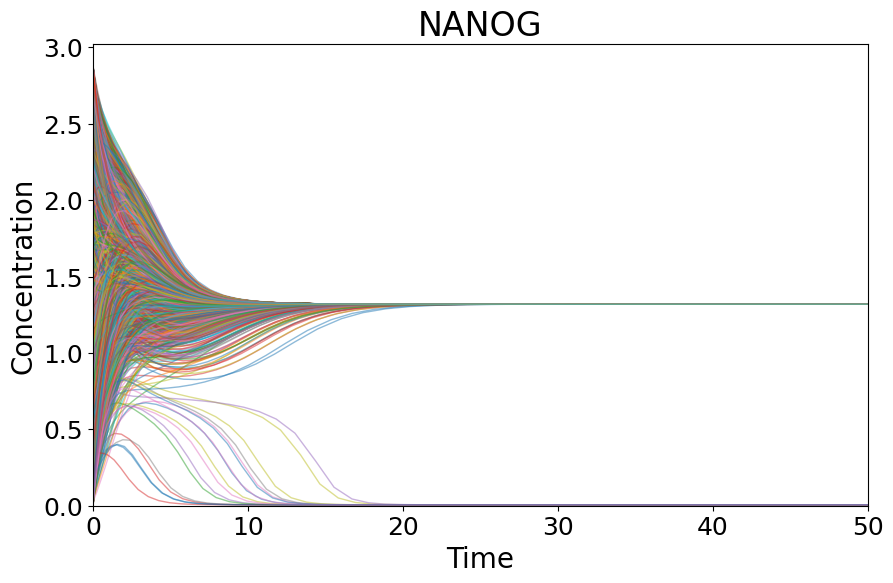

In [63]:
node_num = 3  # Node to plot (3=NANOG)
num_nodes = 26  # Total number of nodes
node_str = names_ordered_26[node_num]  # Get the names of the nodes to plot
plot_sol(sol_26,node_num,node_str,repetitions)

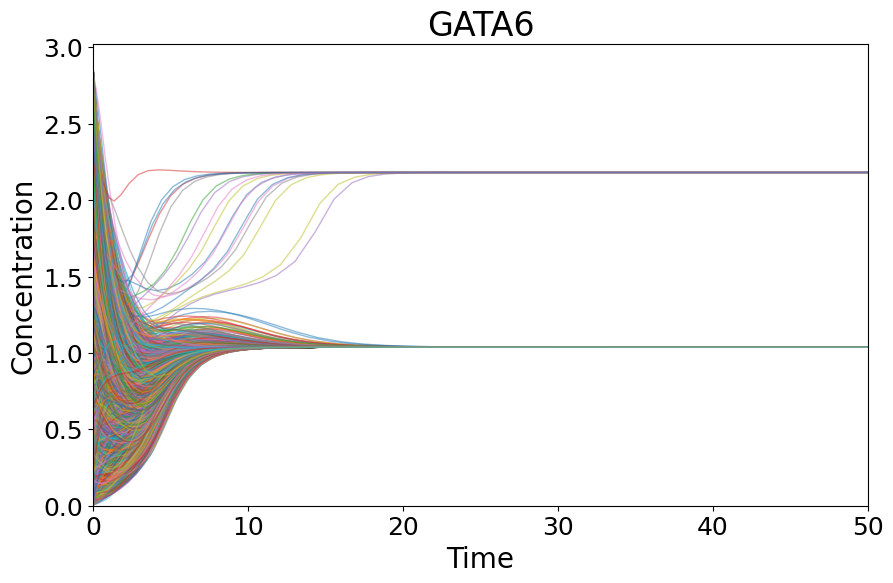

In [64]:
node_num = 9  # Node to plot (9=GATA6)
num_nodes = 26  # Total number of nodes
node_str = names_ordered_26[node_num]  # Get the names of the nodes to plot
plot_sol(sol_26,node_num,node_str,repetitions)

## Knock-out genes experiment. <a class="anchor" id="knock"></a>

We reasoned that the 26-node network may be further reduced. Hence, we now perform knock-out experiments on each gene in the pruned network, and keep save a list of those that have **no** influence on the bistability (within a margin error `eps`).

In [21]:
# Since the code in the cell below is slow, we include its result here.
# 13 nodes were found to have no effect on bistability:
# nodes_unchanged = [11, 13, 14, 15, 16, 18, 19, 20, 21, 23, 24, 25, 26]

In [19]:
# We are going to save the edges that keep the original attractors unchanged:
include("./Data/m26.txt")
# Within a margin error:
eps = 1e-1
# Blank list for the edgess:
nodes_unchanged = []
# Attractors of the original system (two of NANOG and two of GATA6):
# vector_means_original = [
#     maximum(nanog_52[3]), minimum(nanog_52[3]),
#     maximum(gata6_52[3]), minimum(gata6_52[3])
# ]
# Loop through the list of possible edges:
for i in 1:26
    # Reload matrix m26:
    include("./Data/m26.txt")
    # Change the matrix, removing one node at a time:
    m26 = [j for j in m26 if j[1]!=i && j[2]!=i]
    
    # Solve the problem:
    sol_26 = ode_problem_solver(26,ode26,repetitions,[a, b, n, S, k])
    
    # Calculate weights and means:
    _,w,nanog_atr = get_n_weights_alt(
        [sol_26[i].u[end][3] for i in 1:Int(repetitions)],repetitions,0.1
    )
    
    _,w,gata6_atr = get_n_weights_alt(
        [sol_26[i].u[end][9] for i in 1:Int(repetitions)],repetitions,0.1
    )
    
    # Save attractors to compare to the original ones:
    vector_means = [
        maximum(nanog_atr), minimum(nanog_atr),
        maximum(gata6_atr), minimum(gata6_atr)
    ]
    
    # Check if the attractors have changed.
    # First, make sure all weights are non-null:
    if all(w.!=0)
        
        # Then check if the newly calculated attractors are within
        # a margin (eps) of the original ones:
        if all(vector_means .> (vector_means_original.- eps)) && all(vector_means .< (vector_means_original.+ eps))
            # Save the b that keep the attractors unchanged:
            append!(nodes_unchanged,i)
            println(i)
        end
        
    end # if all(w.!=0)
    
    # Check progress:
    print(i,"/26","\t")
    
end; # ends for i in 1:26

println(nodes_unchanged)

1/26	2/26	3/26	4/26	5/26	6/26	7/26	8/26	9/26	10/26	11
11/26	12/26	13
13/26	14
14/26	15
15/26	16
16/26	17/26	18
18/26	19
19/26	20
20/26	21
21/26	22/26	23
23/26	24
24/26	25
25/26	26
26/26	Any[11, 13, 14, 15, 16, 18, 19, 20, 21, 23, 24, 25, 26]


In [107]:
# We re-set m26 to its original value:
include("./Data/m26.txt");

In [20]:
nodes_unchanged

13-element Vector{Any}:
 11
 13
 14
 15
 16
 18
 19
 20
 21
 23
 24
 25
 26

The nodes that are relevant for keeping bistability are:

In [27]:
nodes_ordered_13 = []
for i in 1:26
    if i ∉ nodes_unchanged
        append!(nodes_ordered_13,i)
    end
end
nodes_ordered_13

13-element Vector{Any}:
  1
  2
  3
  4
  5
  6
  7
  8
  9
 10
 12
 17
 22

We can save and print their names:

In [28]:
include("./Data/names_ordered_26.txt")
names_ordered_13 = names_ordered_26[nodes_ordered_13]

("OCT4", "SOX2", "NANOG", "OCT4Sox2", "KLF4", "ZIC3", "PBX1", "GATA4", "GATA6", "CDX2", "cAMP", "LMCD1", "PRDM14")

In [72]:
length(names_ordered_13)

13

We hypothesize that removing all of the nodes (at the same time, nodes at the left of figure below, in cyan) that have no influence on bistability keeps the original bistability unchanged. We can check this by simulating the system of 13 ODEs and comparing to the original solutions.

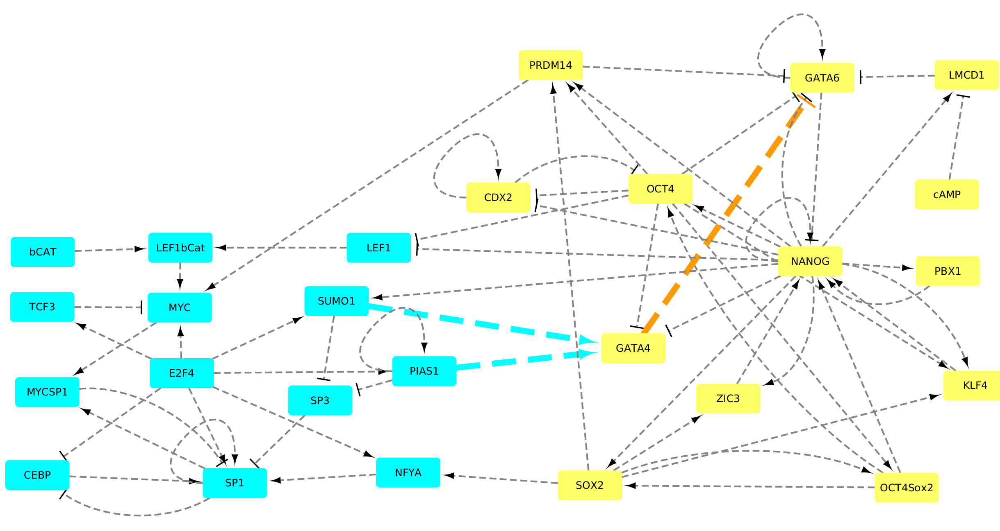

First, we build the sparse matrix that describes the system of ODEs in this 13-node network:

In [88]:
# Create a list of the remaining indeces
# if they are no longer in the matrix,
# substitute with a 0.
after_indexes = []
before_indexes = []
count = 1
for i in 1:length(names_ordered_26)
    if names_ordered_26[i] ∈ names_ordered_13
        append!(after_indexes,count)
        append!(before_indexes,i)
        count += 1
    else
        append!(after_indexes,0)
    end
end

In [51]:
# NANOG new index:
println(after_indexes[3])
# GATA6 new index:
println(after_indexes[9])

3
9


We call `m13` to the resulting sparse matrix (because it has 13 nodes, instead of the 52 of the original):

In [112]:
# Matrix resulting of the knocking-out of genes (with the new nodes not re-ordered):
m26_knock = [j for j in m26 if j[1]∈before_indexes && j[2]∈before_indexes]

# We re-order the nodes:
m13 = []
for i in m26_knock
    push!(m13,[after_indexes[i[1]],after_indexes[i[2]],i[3]])
end

One may save the resulting list of lists `m13` to a text file by copy-pasting the list Julia prints:

In [113]:
# Print the pruned network in "julia format"
# copy and paste into a txt the output:
println("m13 = [")
for i in m13
    println(i,",")
end
println("]")

m13 = [
[1, 4, 1],
[1, 5, 1],
[1, 8, -1],
[1, 9, -1],
[1, 13, 1],
[1, 10, -1],
[2, 4, 1],
[2, 6, 1],
[2, 5, 1],
[2, 13, 1],
[3, 3, 1],
[3, 1, 1],
[3, 7, 1],
[3, 2, 1],
[3, 6, 1],
[3, 5, 1],
[3, 8, -1],
[3, 9, -1],
[3, 13, 1],
[3, 10, -1],
[3, 12, 1],
[4, 2, 1],
[4, 3, 1],
[4, 1, 1],
[5, 3, 1],
[6, 3, 1],
[7, 3, 1],
[8, 9, -1],
[9, 9, 1],
[9, 3, -1],
[10, 10, 1],
[10, 1, -1],
[11, 12, -1],
[12, 9, -1],
[13, 9, -1],
]


The resulting network is:

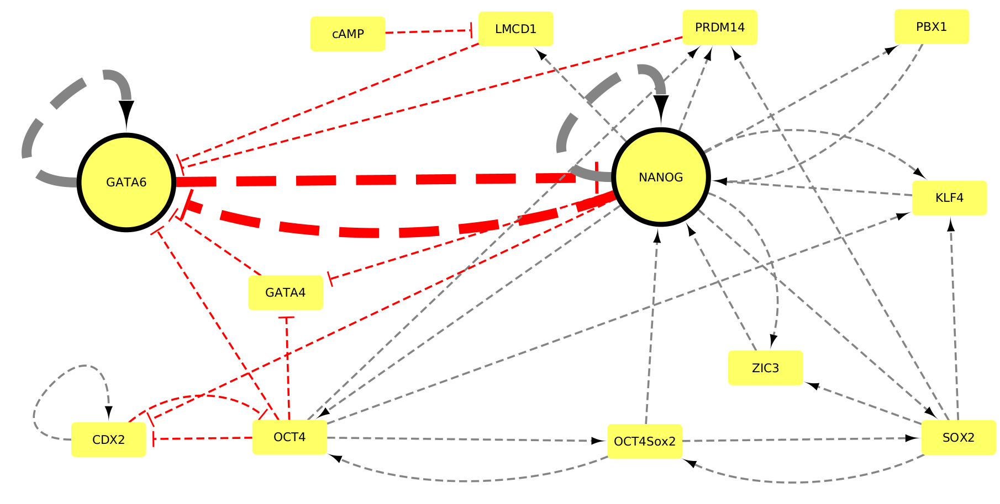

### Bistability of the 13-node network.

Now that we have the sparse matrix `m13` we can solve the corresponding system of ODEs.

In [114]:
# Function to describe TF (nodes) connections:
function ode13(x,p,t)
    
    xi = zeros(13) #13 factors
    
    for i in 1:13
        xi[i] -= k*x[i]
    end

    #Sum over the different connections in the sparse matrix
    for i in m13

        # If i[3]==1, we have an activator:
        if i[3] == 1
            xi[i[2]] += a*x[i[1]]^n/(S^n + x[i[1]]^n)
        # If i[3]==-1, we have a repressor:
        else
            xi[i[2]] += b*S^n/(S^n + x[i[1]]^n)
        end
    end

    return xi
end;

In [115]:
# Solve the problem a number of repetitions:
sol_13 = ode_problem_solver(13, ode13, repetitions, [a, b, n, S, k]);

In [116]:
# Obtain the attractors for NANOG:
nanog_13 = get_n_weights_alt([sol_13[i].u[end][3] for i in 1:Int(repetitions)],repetitions,0.1)

3-element Vector{Any}:
 2
  [0.9989, 0.0011]
  [1.3161043944761166, 0.005954027922487713]

In [117]:
# Obtain the attractors for GATA6:
gata6_13 = get_n_weights_alt([sol_13[i].u[end][9] for i in 1:Int(repetitions)],repetitions,0.1)

3-element Vector{Any}:
 2
  [0.9989, 0.0011]
  [1.0586841607167063, 2.1809877576044885]

Besides, we can also easily plot the solutions of a node:

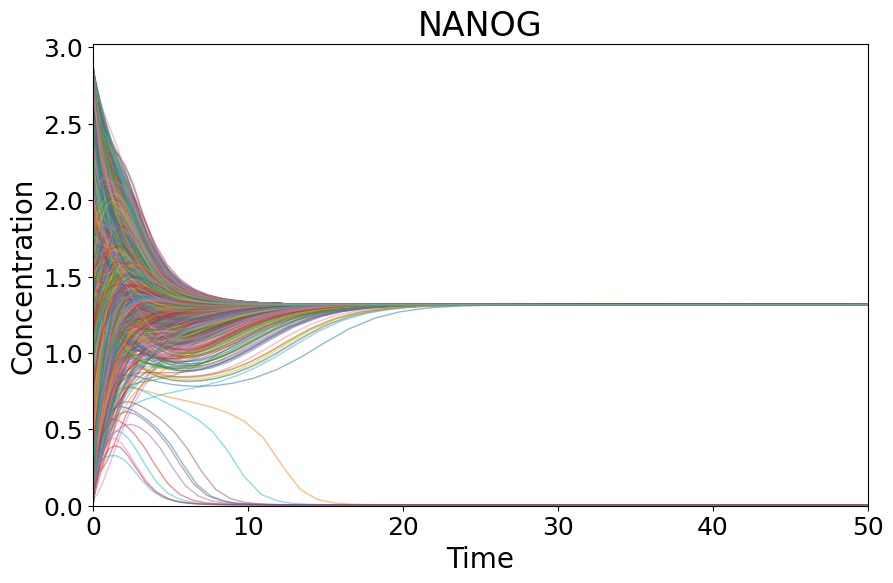

In [118]:
node_num = 3  # Node to plot (3=NANOG)
num_nodes = 13  # Total number of nodes
node_str = names_ordered_13[node_num]  # Get the names of the nodes to plot
plot_sol(sol_13,node_num,node_str,repetitions)

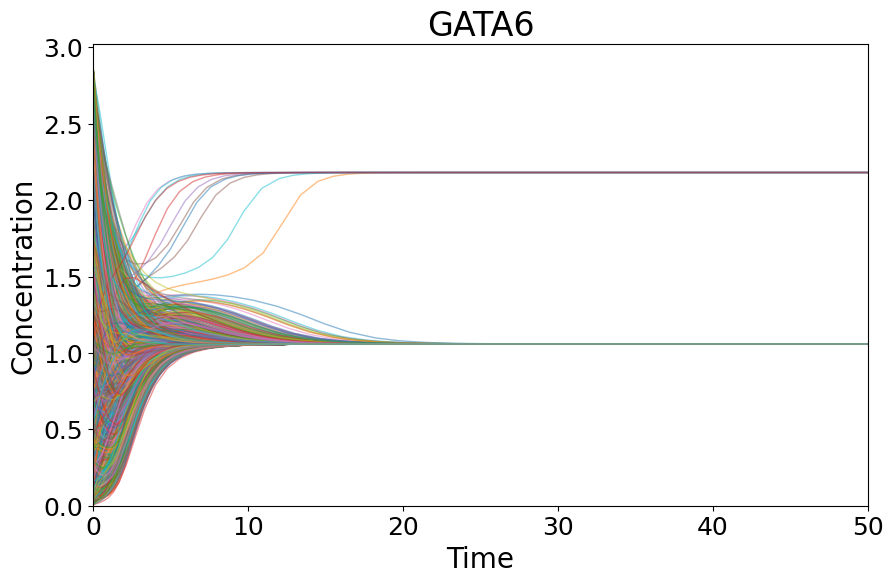

In [119]:
node_num = 9  # Node to plot (9=GATA6)
num_nodes = 13  # Total number of nodes
node_str = names_ordered_13[node_num]  # Get the names of the nodes to plot
plot_sol(sol_13,node_num,node_str,repetitions)